In [1]:
import cv2
from darkflow.net.build import TFNet
import numpy as np
import matplotlib.pyplot as plt
import os

In [2]:
flags = {
    'model' :'cfg/tiny-yolo-voc-1c.cfg',
    'load' : 'bin/tiny-yolo-voc.weights',
    'threshold' : 0.6, 
    'gpu' : 1.0   
} 

tfnet = TFNet(flags)

Parsing ./cfg/tiny-yolo-voc.cfg
Parsing cfg/tiny-yolo-voc-1c.cfg
Loading bin/tiny-yolo-voc.weights ...
Successfully identified 63471556 bytes
Finished in 0.009974241256713867s

Building net ...
Source | Train? | Layer description                | Output size
-------+--------+----------------------------------+---------------
Instructions for updating:
Colocations handled automatically by placer.
       |        | input                            | (?, 416, 416, 3)
 Load  |  Yep!  | conv 3x3p1_1  +bnorm  leaky      | (?, 416, 416, 16)
 Load  |  Yep!  | maxp 2x2p0_2                     | (?, 208, 208, 16)
 Load  |  Yep!  | conv 3x3p1_1  +bnorm  leaky      | (?, 208, 208, 32)
 Load  |  Yep!  | maxp 2x2p0_2                     | (?, 104, 104, 32)
 Load  |  Yep!  | conv 3x3p1_1  +bnorm  leaky      | (?, 104, 104, 64)
 Load  |  Yep!  | maxp 2x2p0_2                     | (?, 52, 52, 64)
 Load  |  Yep!  | conv 3x3p1_1  +bnorm  leaky      | (?, 52, 52, 128)
 Load  |  Yep!  | maxp 2x2p0_2       

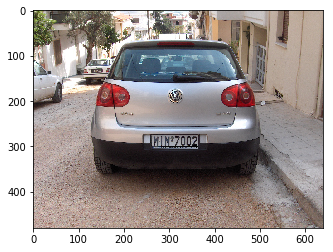

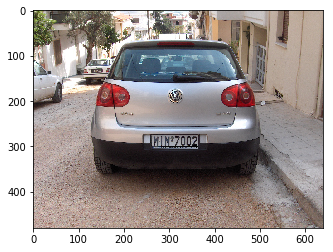

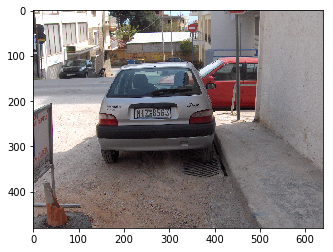

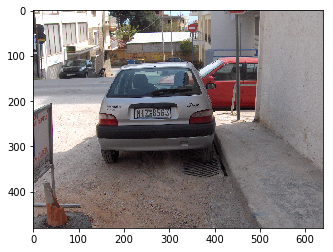

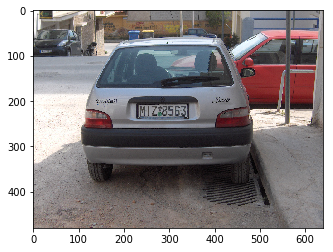

...

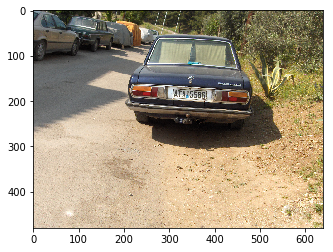

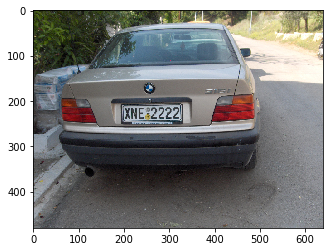

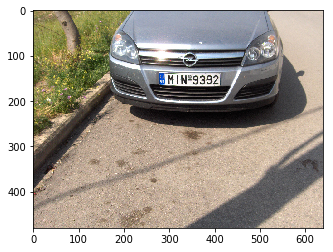

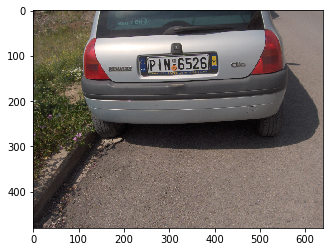

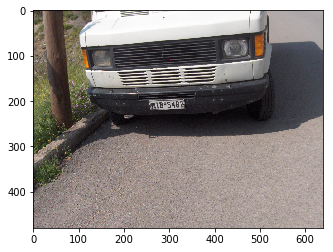

OSError: [Errno 22] Invalid argument: 'C:\\AI\\darkflow\\darkflow-master\\dataset\\result\\241.jpg'

In [11]:
testpath = 'C:\\AI\\darkflow\\darkflow-master\\dataset\\lptest'
resultpath = 'C:\\AI\\darkflow\\darkflow-master\\dataset\\result'

count = 0
for file in os.scandir(testpath):
    img = plt.imread(file.path)
    
    name, ext = os.path.splitext(file.name)
    
    prediction = tfnet.return_predict(img)
    
    counter = 1
    
    for i in range(len(prediction)):
        tl = (prediction[i]['topleft']['x'], prediction[i]['topleft']['y'])
        br = (prediction[i]['bottomright']['x'], prediction[i]['bottomright']['y'])
        label = prediction[i]['label']
        
        #cropped = img[tl[1]:br[1], tl[0]:br[0]]
        #croppedname = name + '.jpg'
        
        #img = cv2.rectangle(img, tl, br, (255,0,0), 7)
        #img = cv2.putText(img,'license plate',br,cv2.FONT_HERSHEY_COMPLEX,1,(0,0,0),2)
        
        '''
        plt.figure()
        plt.imshow(cropped)
        plt.show()
        '''
        
        savepath = os.path.join(resultpath, croppedname)
        plt.imsave(savepath, cropped)
        
    
        if counter == 5:
            break
        else:
            counter += 1
            
    plt.figure()
    plt.imshow(img)
    plt.show()